Exploring the pretrained YOLO model for object detection

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F

import matplotlib.pyplot as plt
import cv2
import numpy as np
from PIL import Image
import requests


In [2]:
# Model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True, verbose= False)



YOLOv5 🚀 2023-3-27 Python-3.10.9 torch-2.0.0 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 


In [4]:
imgs = ['https://static.vecteezy.com/system/resources/thumbnails/001/338/914/small/colorful-realistic-bird-set-free-vector.jpg','https://images.pexels.com/photos/1821374/pexels-photo-1821374.jpeg','https://thumbs.dreamstime.com/b/fruit-vegetables-7134858.jpg']

images=[Image.open(requests.get(i, stream=True).raw)  for i in imgs]
# compress the image
images = [i.resize((int(i.width * 0.7),int(i.height * 0.7))) for i in images]

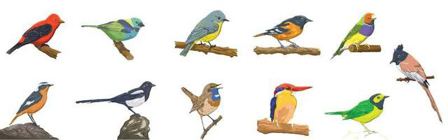

In [5]:
images[0]

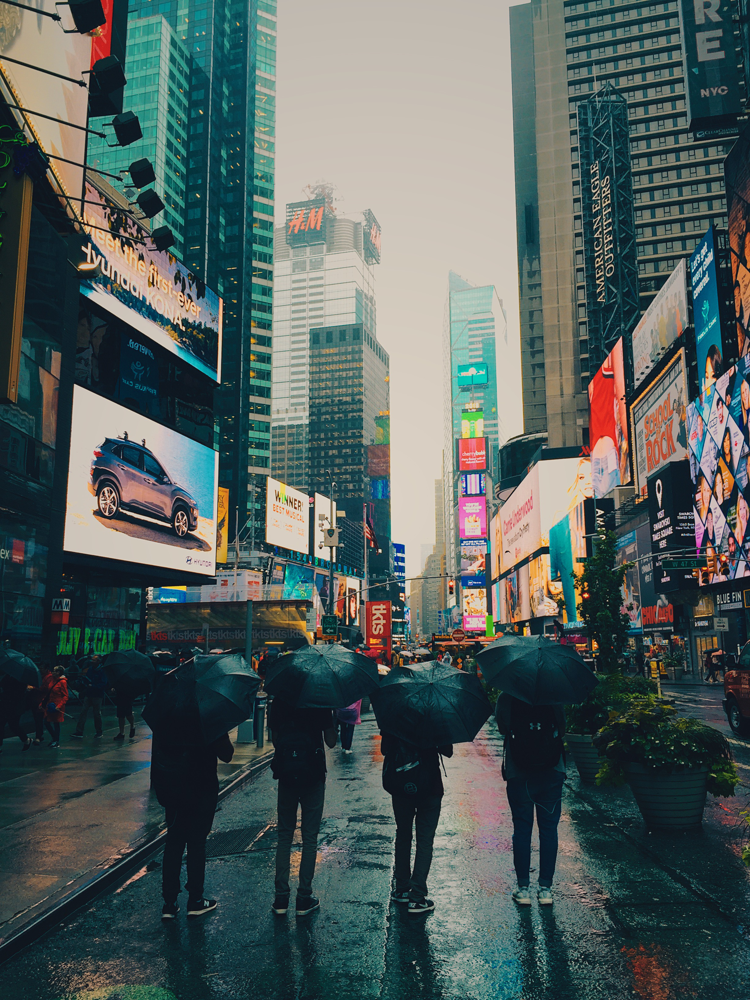

In [6]:
images[1]

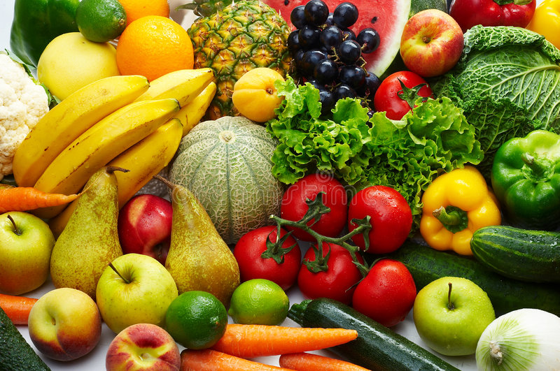

In [7]:
images[2]

In [8]:
# run inference
results = model(images)


In [9]:
results.print()

image 1/3: 140x448 12 birds
image 2/3: 2284x1713 9 persons, 2 cars, 6 umbrellas, 1 potted plant
image 3/3: 371x560 1 banana, 10 apples, 2 oranges, 2 carrots
Speed: 4.7ms pre-process, 242.3ms inference, 0.9ms NMS per image at shape (3, 3, 640, 640)


In [10]:
results.pandas().xyxy

[          xmin        ymin        xmax        ymax  confidence  class  name
 0     6.061701   13.588914   64.065796   58.398087    0.860808     14  bird
 1   175.372498   10.380094  231.072235   57.890327    0.857565     14  bird
 2   329.988556   11.380041  378.593536   59.248821    0.849742     14  bird
 3   388.844208   43.208103  442.883087  122.883728    0.828796     14  bird
 4   251.325180   15.091218  316.335144   54.533562    0.810189     14  bird
 5    74.221527   80.950356  155.964706  111.392151    0.797133     14  bird
 6     6.278619   81.554482   54.739922  126.593910    0.780282     14  bird
 7    80.042976   16.881081  145.361511   61.491180    0.720601     14  bird
 8   262.778290   82.115097  314.199860  130.849854    0.716464     14  bird
 9   323.158417   91.583488  390.434509  133.230331    0.682403     14  bird
 10  180.119125   81.612610  223.704086  132.819855    0.509219     14  bird
 11  116.169342  112.829964  152.855377  139.403305    0.265250     14  bird

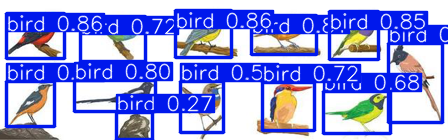

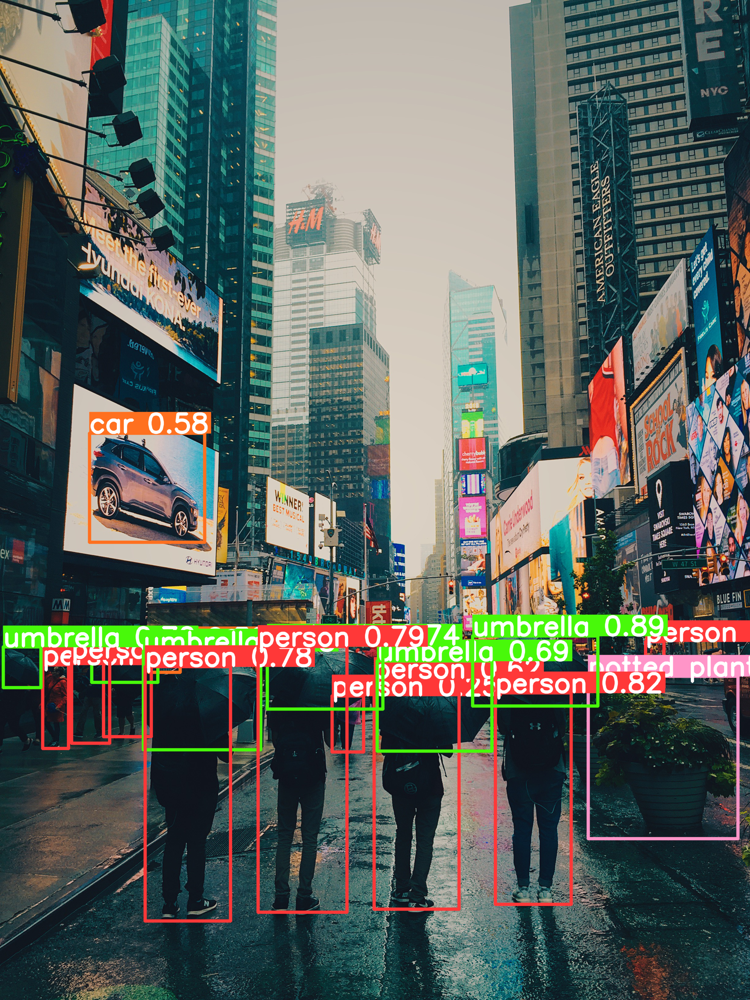

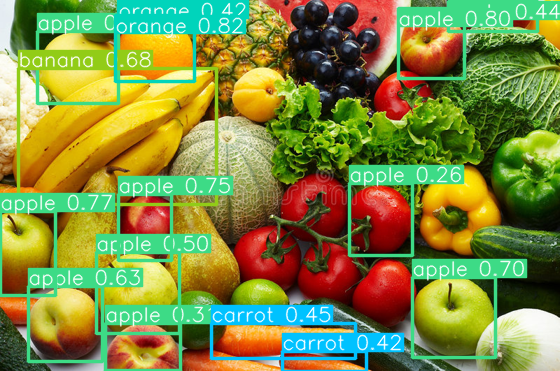

In [11]:
# show results as image
results.show()

In [12]:
# lets try another object detection model
model = torch.hub.load('ultralytics/yolov5', 'yolov5m', pretrained=True, verbose= False)

YOLOv5 🚀 2023-3-27 Python-3.10.9 torch-2.0.0 CPU

Fusing layers... 
YOLOv5m summary: 290 layers, 21172173 parameters, 0 gradients
Adding AutoShape... 


In [13]:
# run inference
results = model(images)

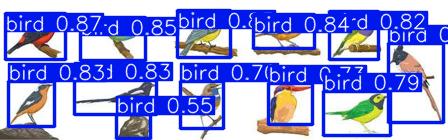

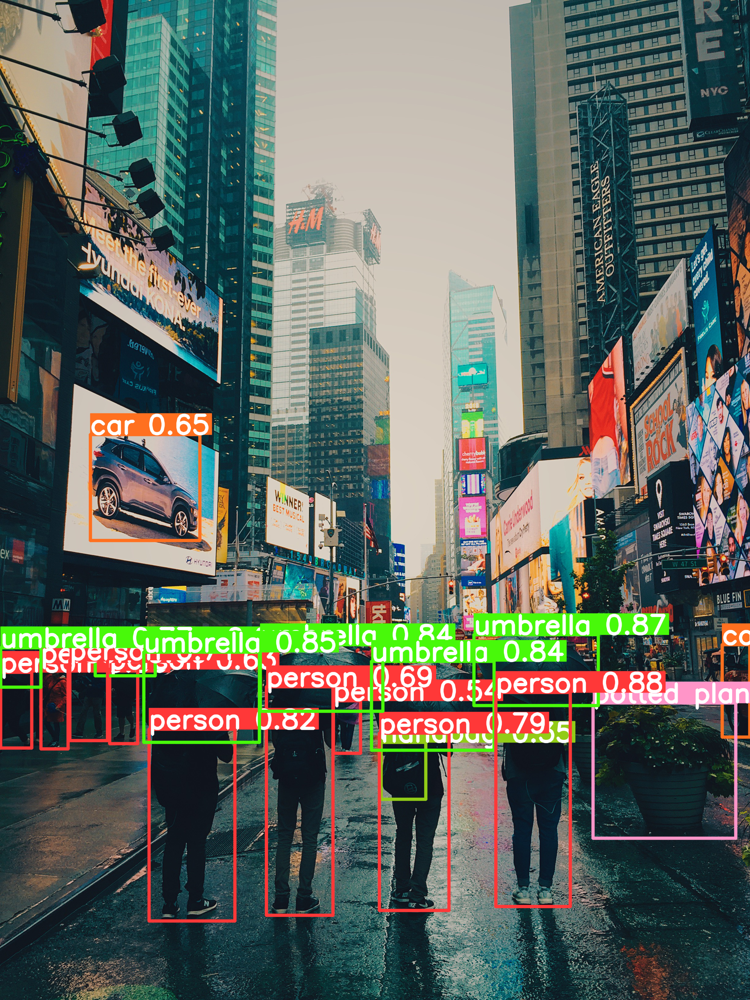

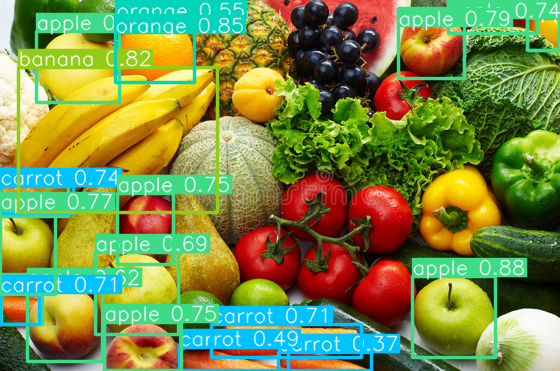

In [14]:
results.show()

> This one is a larger model and is more confident and accurate in its predictions (notice the higher probabilities)